In [1]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append('../../')
sys.path.append('../../hovernet')
sys.path.append('../../hedest')

import json
import os
import pickle
import torch
import scanpy as sc

PATH = '/home/luca/Documents/data/'

#'/cluster/CBIO/data1/lgortana/'
#'/home/luca/Documents/data/'

# Load data

In [2]:
# names
adata_name = 'Xenium_V1_humanLung_Cancer_FFPE'
# atlas_name = 'LuCA'
sim_tag = 'real'
model_tag = 'model_quick_alpha_0.0_lr_0.0003_divergence_l2_beta_0.0_seed_4' #seed 9

In [3]:
import pandas as pd

data_path = os.path.join(PATH, adata_name)
sim_path = os.path.join(data_path, "sim", "LuCA")

#load images
image_path = os.path.join(data_path, 'tif', 'Xenium_V1_humanLung_Cancer_FFPE_he_image.ome.tif')
image_dict = torch.load(os.path.join(sim_path, 'image_dict_64.pt'))

#load ground truth
ground_truth = pd.read_csv(os.path.join(sim_path, f'sim_{adata_name}_gt.csv'), index_col=0)
ground_truth.index = ground_truth.index.astype(str)

In [4]:
#load adata
path_ST_adata = os.path.join(sim_path, f"pseudo_adata_{sim_tag}.h5ad")
adata = sc.read_h5ad(path_ST_adata)

#load proportions
spot_prop_df = pd.read_csv(os.path.join(sim_path, f'sim_{adata_name}_prop_{sim_tag}.csv'), index_col=0)
spot_prop_df.index = spot_prop_df.index.astype(str)
ct_list = list(spot_prop_df.columns)

#load segmentation
json_path = os.path.join(sim_path, "pannuke_fast_mask_lvl3_annotated.json")
with open(json_path) as json_file:
    hovernet_dict = json.load(json_file)

#color_dict annotated hovernet
from hedest.utils import generate_color_dict
dict_types_colors = generate_color_dict(ct_list, format='special')
dict_types_colors[f'{len(ct_list)}'] = ['unlabeled', [0, 0, 0, 255]]
dict_types_colors[f'{len(ct_list)+1}'] = ['no_match', [170, 170, 170, 255]]

# Annotated Xenium data (ground truth)

In [5]:
from hedest.analysis.postseg import StdVisualizer

plotter = StdVisualizer(image_path=image_path,
                        adata=adata,
                        adata_name=adata_name,
                        seg_dict=hovernet_dict,
                        color_dict=dict_types_colors)

Visium data found.


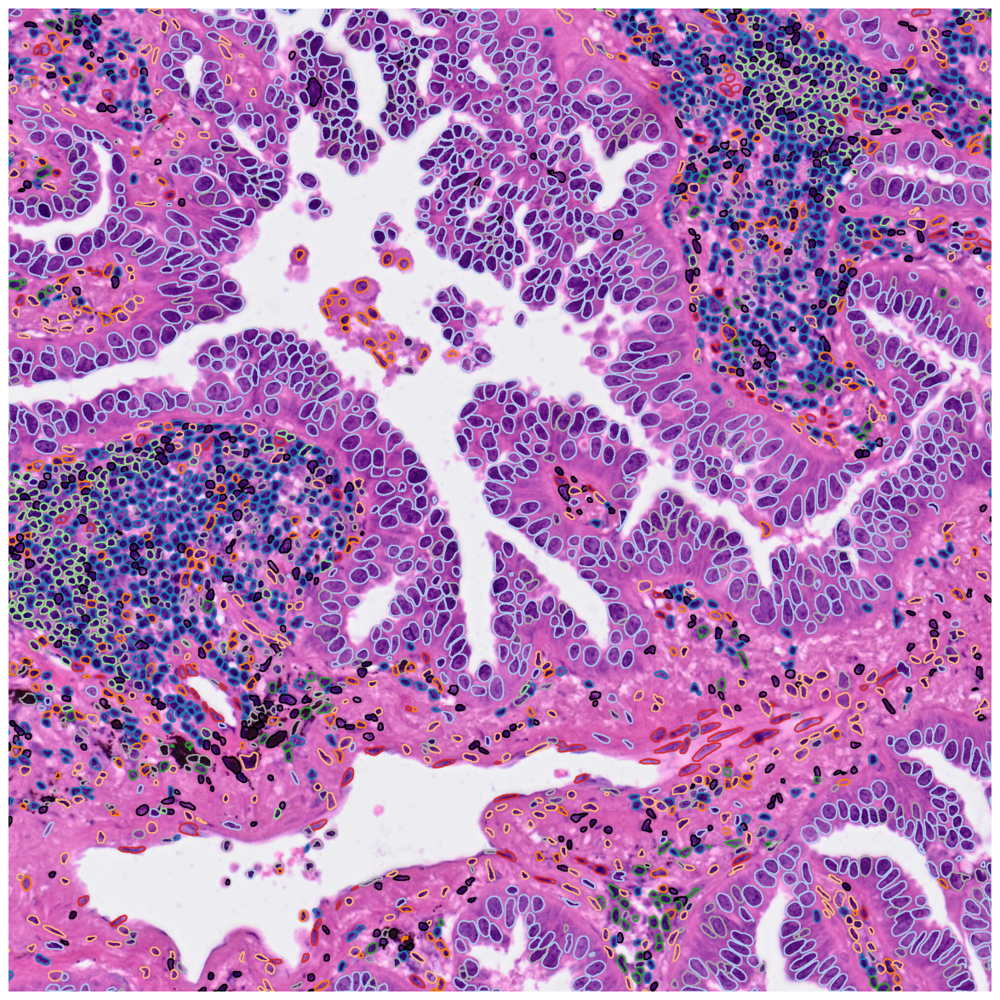

In [6]:
window = ((4000, 15000), (2000, 2000)) #((3000, 20000), (2000, 2000))
plotter.plot_seg(window=window, title="", show_visium=False, display=False)
# fig.savefig("figures/semi-sim/Xenium_Human_Breast_Cancer_Rep1_gt_4000_15000_2000.png", dpi=300, bbox_inches='tight')

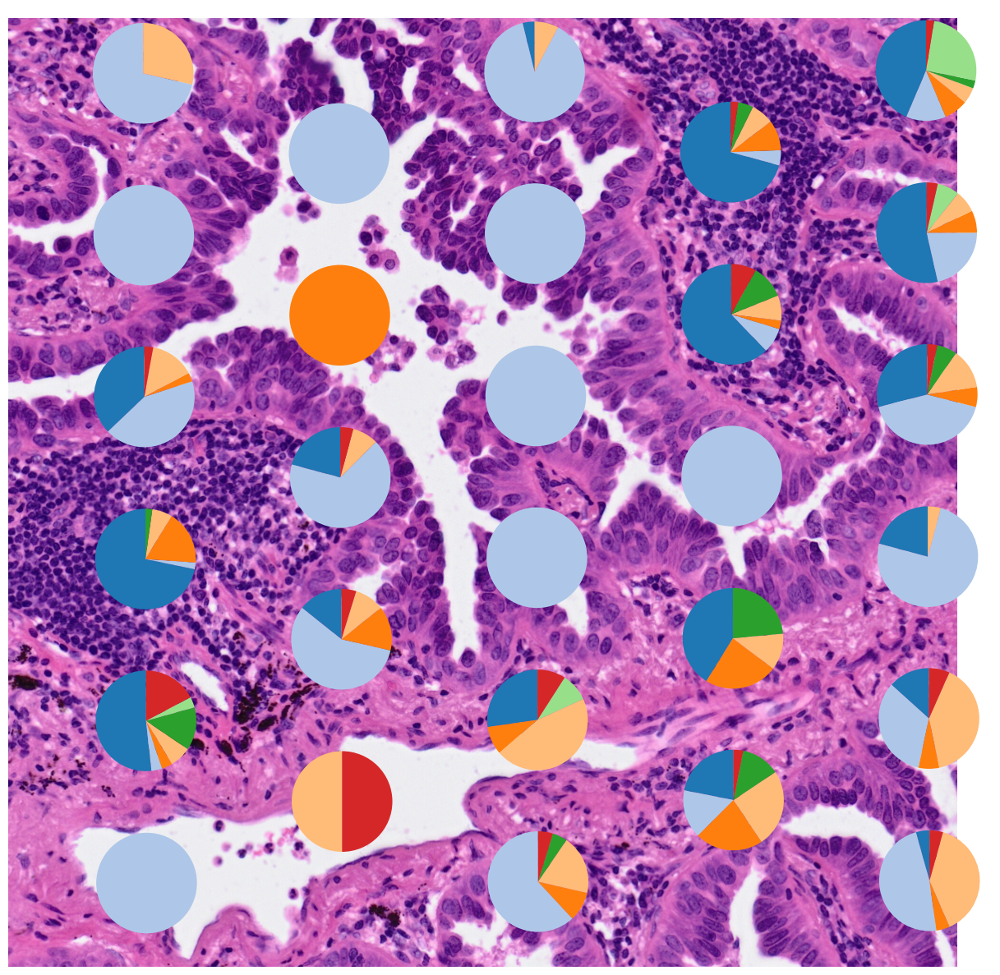

In [7]:
window = ((4000, 15000), (2000, 2000))
plotter.plot_slide(window, title="", spot_prop_df=spot_prop_df, show_visium=True, display=False)
# fig.savefig("figures/semi-sim/Xenium_Human_Breast_Cancer_Rep1_prop_4000_15000_2000.png", dpi=300, bbox_inches='tight')

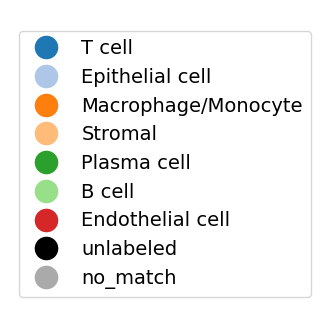

In [8]:
from hedest.analysis.plots import plot_legend

plot_legend(dict_types_colors)

# Model predictions

In [9]:
#load model infos
model_dir = os.path.join(f'../../benchmark/results/HistoCell/{adata_name}/HEDeST/7types/', model_tag)

with open(os.path.join(model_dir, 'info.pickle'), 'rb') as f:
    model_info = pickle.load(f)

In [10]:
from hedest.analysis.pred_analyzer import PredAnalyzer

analyzer = PredAnalyzer(model_info=model_info,
                        adjusted=True,
                        ground_truth=ground_truth, 
                        image_dict=image_dict
                        )

Loading predicted labels...
Loading true labels...
Use `add_attributes(seg_dict=your_seg_dict)` to add one.


In [11]:
analyzer.add_attributes(adata=adata,
                        adata_name=adata_name,
                        image_path=image_path,
                        seg_dict=hovernet_dict)

In [12]:
from hedest.analysis.postseg import StdVisualizer

plotter = StdVisualizer(image_path, 
                        adata, 
                        adata_name, 
                        seg_dict=analyzer.seg_dict_w_class,
                        color_dict=analyzer.color_dict)

Visium data found.


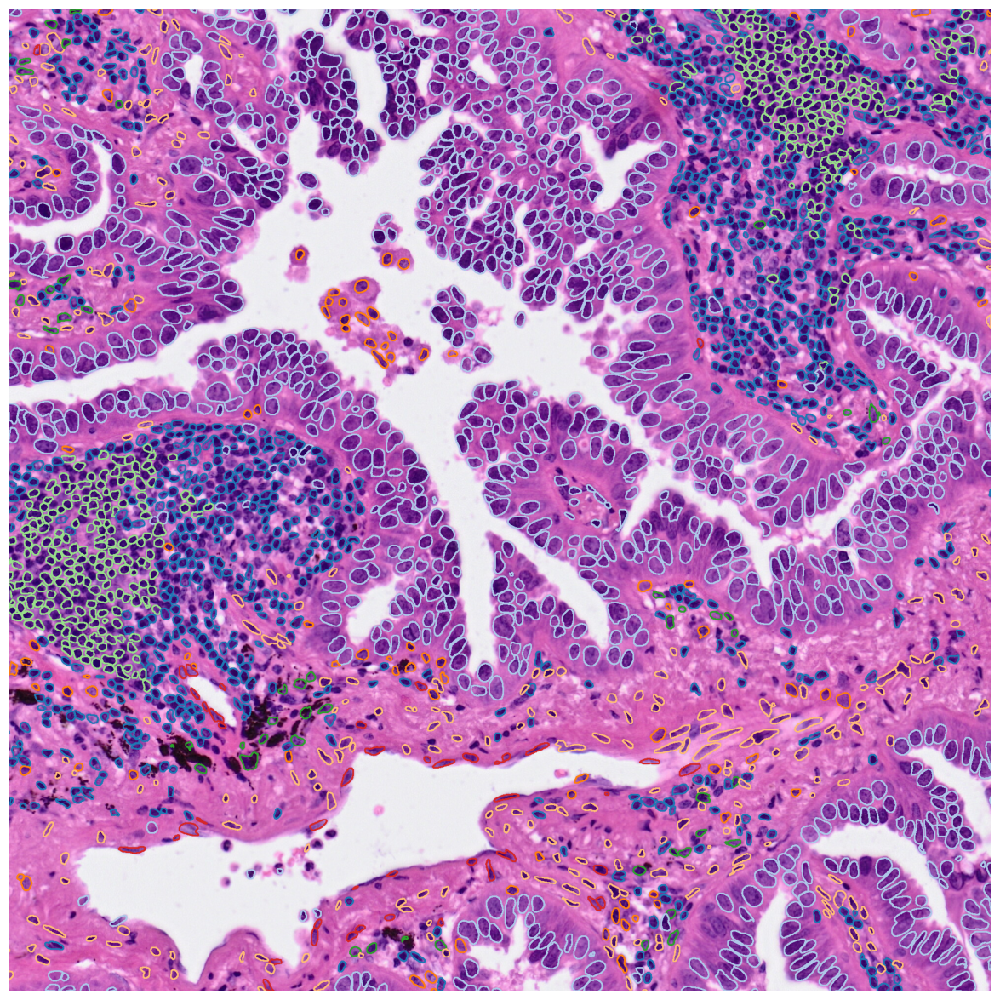

In [13]:
window = ((4000, 15000), (2000, 2000)) #((6000, 20000), (2000, 2000))
plotter.plot_seg(window=window, show_visium=False, display=False, title="")
# fig.savefig("figures/semi-sim/Xenium_Human_Breast_Cancer_Rep1_hedest_4000_15000_2000.png", dpi=300, bbox_inches='tight')

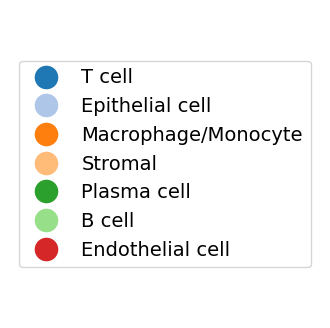

In [14]:
plot_legend(analyzer.color_dict)

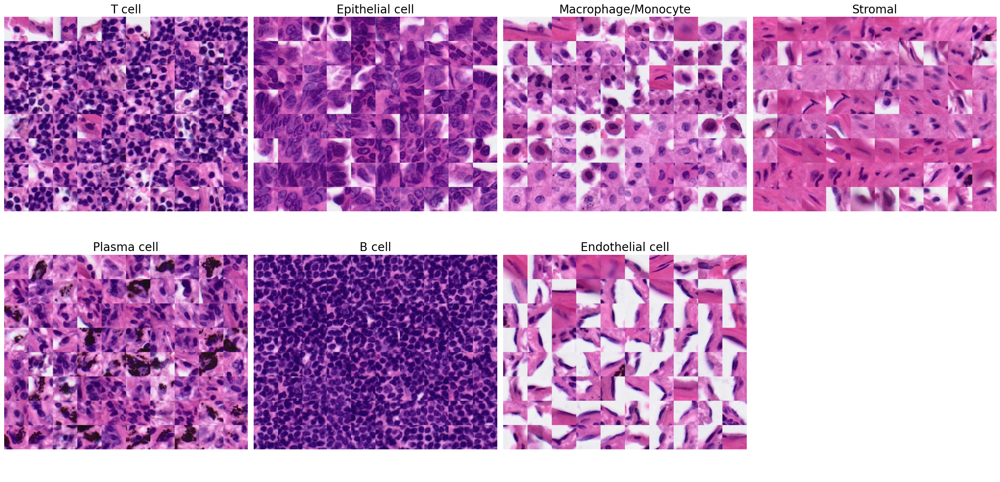

In [15]:
analyzer.plot_grid_celltype(selection='max', show_probs=False, n=80, nrows=2, ncols=4, display=False)
# fig.savefig("figures/semi-sim/Xenium_V1_humanLung_Cancer_FFPE_hedest_grid.png", dpi=300, bbox_inches='tight')

In [16]:
from hedest.analysis.postseg import IntVisualizer

plotter_int = IntVisualizer(image_path, 
                        adata, 
                        adata_name, 
                        seg_dict=analyzer.seg_dict_w_class,
                        color_dict=analyzer.color_dict)

Visium data found.


In [18]:
window = ((4000, 15000), (2000, 2000)) #((6000, 20000), (2000, 2000))
plotter_int.plot_seg(window=window, show_visium=True, display=True, title="")

In [19]:
analyzer.evaluate_prop_predictions()

{'Pearson Correlation T cell': 0.9416108559104708,
 'Spearman Correlation T cell': 0.9858907977539545,
 'MSE T cell': 0.003340179121331685,
 'MAE T cell': 0.026855596739672923,
 'Pearson Correlation Epithelial cell': 0.9830861707942187,
 'Spearman Correlation Epithelial cell': 0.9835849299277094,
 'MSE Epithelial cell': 0.00519343955751504,
 'MAE Epithelial cell': 0.040404879834166824,
 'Pearson Correlation Macrophage/Monocyte': 0.9312102551217444,
 'Spearman Correlation Macrophage/Monocyte': 0.9583753480250765,
 'MSE Macrophage/Monocyte': 0.0027315128526446673,
 'MAE Macrophage/Monocyte': 0.026183084016735168,
 'Pearson Correlation Stromal': 0.958251328008554,
 'Spearman Correlation Stromal': 0.9804802837367566,
 'MSE Stromal': 0.004415811603075507,
 'MAE Stromal': 0.032902138555941395,
 'Pearson Correlation Plasma cell': 0.9421455712593839,
 'Spearman Correlation Plasma cell': 0.9988623849648978,
 'MSE Plasma cell': 0.000851235688071544,
 'MAE Plasma cell': 0.007755468038194071,
 'Pe